# ***Bilgiler***


*   **ONUR ÇAKIR 254329008**
*   https://github.com/onurc4kir/digital-image-processing



**1.1. Kütüphanelerin İçe Aktarılması**

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from google.colab import drive
from PIL import Image


In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**1.2. Veri Setinin Yüklenmesi**

In [ ]:
train_dir = 'drive/My Drive/Colab Notebooks/skin-cancer-isic-data/Train'
test_dir  = 'drive/My Drive/Colab Notebooks/skin-cancer-isic-data/Test'

# Get class names (folder names)
class_names = sorted(os.listdir(train_dir))
num_classes = len(class_names)

# Create label mapping
label_map = {i: class_name for i, class_name in enumerate(class_names)}
print("Class mapping:")
for i, class_name in label_map.items():
    print(f"{i}: {class_name}")

# Create DataFrames for train and test
def create_dataframe(directory):
    data = []
    for class_label, class_name in enumerate(class_names):
        class_dir = os.path.join(directory, class_name)
        for filename in os.listdir(class_dir):
            if filename.endswith('.jpg'):
                image_path = os.path.join(class_dir, filename)
                data.append({'image_path': image_path, 'label': class_label})
    return pd.DataFrame(data)

train_df = create_dataframe(train_dir)
test_df = create_dataframe(test_dir)

# Combine for EDA
df = pd.concat([train_df, test_df], ignore_index=True)

print(f"\nTotal images: {len(df)}")
print(f"Number of classes: {num_classes}")
df.head()

Class mapping:
0: actinic keratosis
1: basal cell carcinoma
2: dermatofibroma
3: melanoma
4: nevus
5: pigmented benign keratosis
6: seborrheic keratosis
7: squamous cell carcinoma
8: vascular lesion

Total images: 2357
Number of classes: 9


,image_path,label
0,drive/My Drive/Colab Notebooks/skin-cancer-isi...,0
1,drive/My Drive/Colab Notebooks/skin-cancer-isi...,0
2,drive/My Drive/Colab Notebooks/skin-cancer-isi...,0
3,drive/My Drive/Colab Notebooks/skin-cancer-isi...,0
4,drive/My Drive/Colab Notebooks/skin-cancer-isi...,0


**1.3. Veri Özelliklerinin İncelenmesi**

In [ ]:
sampled_df = df.sample(frac=0.05, random_state=42)
print(f"Orijinal veri boyutu: {len(train_df)}")
print(f"Örnekleme için alınan sampled_df boyutu (5%): {len(sampled_df)}")
sampled_df.head()

Orijinal veri boyutu: 2239
Örnekleme için alınan sampled_df boyutu (5%): 118


,image_path,label
1650,drive/My Drive/Colab Notebooks/skin-cancer-isi...,5
1073,drive/My Drive/Colab Notebooks/skin-cancer-isi...,4
1604,drive/My Drive/Colab Notebooks/skin-cancer-isi...,5
2122,drive/My Drive/Colab Notebooks/skin-cancer-isi...,8
179,drive/My Drive/Colab Notebooks/skin-cancer-isi...,1


**Reasoning**:
Örnek data içerisinden (`sampled_df`). Resim özelliklerini ve çeşitli bilgileri çıkaralım, bunun için  `PIL.Image` ve `os` kullanacağım



In [ ]:
widths = []
heights = []
channels = []
file_sizes = []

for index, row in sampled_df.iterrows():
    image_path = row['image_path']
    try:
        with Image.open(image_path) as img:
            widths.append(img.width)
            heights.append(img.height)
            channels.append(len(img.getbands()))
        file_sizes.append(os.path.getsize(image_path))
    except FileNotFoundError:
        print(f"File not found: {image_path}")
        widths.append(None)
        heights.append(None)
        channels.append(None)
        file_sizes.append(None)

# Add the extracted features to the sampled_df
sampled_df['width'] = widths
sampled_df['height'] = heights
sampled_df['channels'] = channels
sampled_df['file_size'] = file_sizes

print("Resim özellikleri: ")
sampled_df.head()

Resim özellikleri: 


,image_path,label,width,height,channels,file_size
1650,drive/My Drive/Colab Notebooks/skin-cancer-isi...,5,600,450,3,325757
1073,drive/My Drive/Colab Notebooks/skin-cancer-isi...,4,1504,1129,3,100263
1604,drive/My Drive/Colab Notebooks/skin-cancer-isi...,5,600,450,3,302673
2122,drive/My Drive/Colab Notebooks/skin-cancer-isi...,8,600,450,3,264592
179,drive/My Drive/Colab Notebooks/skin-cancer-isi...,1,600,450,3,264376


***Resim özelliklerini grafikler ile gösterelim ve anlamlandıralım***

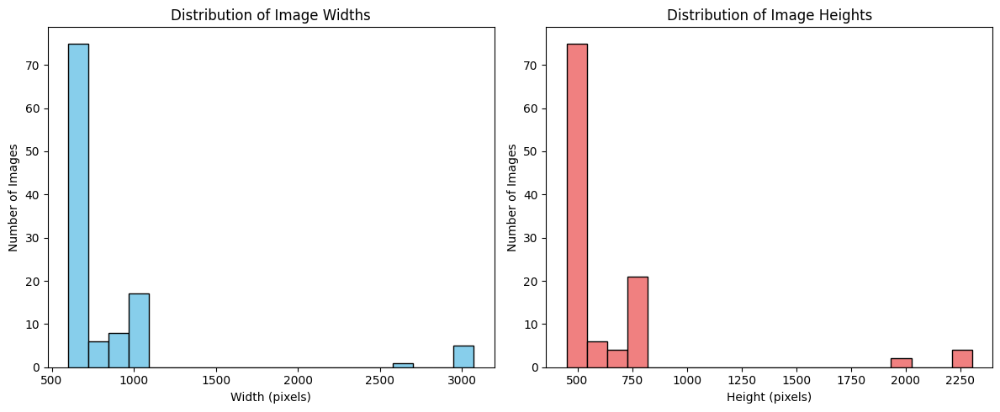

In [ ]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(sampled_df['width'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Image Widths')
plt.xlabel('Width (pixels)')
plt.ylabel('Number of Images')

plt.subplot(1, 2, 2)
plt.hist(sampled_df['height'], bins=20, color='lightcoral', edgecolor='black')
plt.title('Distribution of Image Heights')
plt.xlabel('Height (pixels)')
plt.ylabel('Number of Images')

plt.tight_layout()
plt.show()


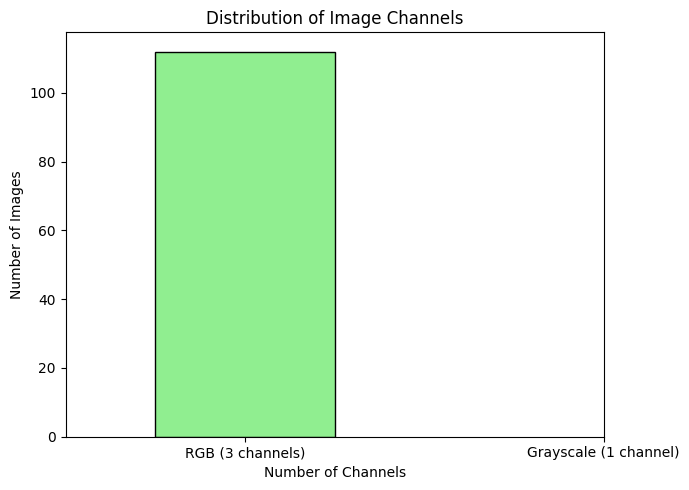

In [ ]:
channel_counts = sampled_df['channels'].value_counts()

plt.figure(figsize=(7, 5))
channel_counts.plot(kind='bar', color=['lightgreen', 'darkseagreen'], edgecolor='black')
plt.title('Distribution of Image Channels')
plt.xlabel('Number of Channels')
plt.ylabel('Number of Images')
plt.xticks(ticks=[0, 1], labels=['RGB (3 channels)', 'Grayscale (1 channel)'], rotation=0)
plt.tight_layout()
plt.show()

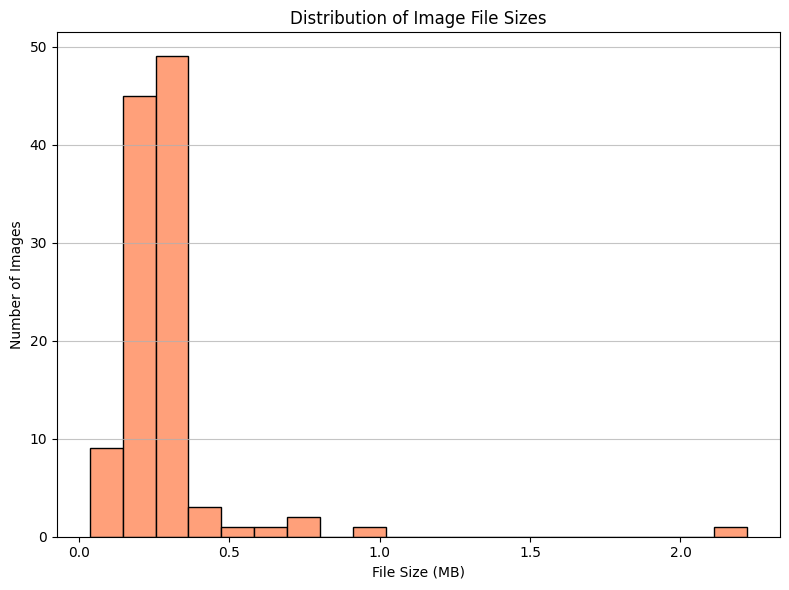

In [ ]:
plt.figure(figsize=(8, 6))
plt.hist(sampled_df['file_size'] / (1024 * 1024), bins=20, color='lightsalmon', edgecolor='black') # Convert to MB
plt.title('Distribution of Image File Sizes')
plt.xlabel('File Size (MB)')
plt.ylabel('Number of Images')
plt.grid(axis='y', alpha=0.75)
plt.tight_layout()
plt.show()

### Resim Özelliklerin Yapılan Çıkarımlar

*   **Çözünürlük (Width and Height)**:
    *  Resimlerin büyük bir kısmı 600x450 boyutundadır. Az miktarda outlier bulunuyor fakat büyük çoğunluğu standart bir boyutu getirilmiş. Bu outliler olan resimlerle ilerleyen bölümlerde ilgineceğim.

*   **Resimlerin Kanalı (Color Mode)**:
    *   Resimlerin tamamı RGB.

*   **Dosya Boyutu**:
    *   Yapılan örneklemede resimlerin tamamının 1mb'tan küçük olduğu ve çoğunluğnun 0.3-0.4mb arasında olduğu görülmüştür

# **2. Görüntü Yükleme ve Görselleştirme**

In [ ]:
random_sample_df = train_df.sample(n=9, random_state=42)
print("Rastgele seçilmiş 9 resim")
random_sample_df

Selected 9 random images from train_df:


,image_path,label
1513,drive/My Drive/Colab Notebooks/skin-cancer-isi...,5
111,drive/My Drive/Colab Notebooks/skin-cancer-isi...,0
1922,drive/My Drive/Colab Notebooks/skin-cancer-isi...,7
461,drive/My Drive/Colab Notebooks/skin-cancer-isi...,1
2171,drive/My Drive/Colab Notebooks/skin-cancer-isi...,8
1544,drive/My Drive/Colab Notebooks/skin-cancer-isi...,5
599,drive/My Drive/Colab Notebooks/skin-cancer-isi...,3
617,drive/My Drive/Colab Notebooks/skin-cancer-isi...,3
544,drive/My Drive/Colab Notebooks/skin-cancer-isi...,2


<Figure size 1500x1500 with 0 Axes>

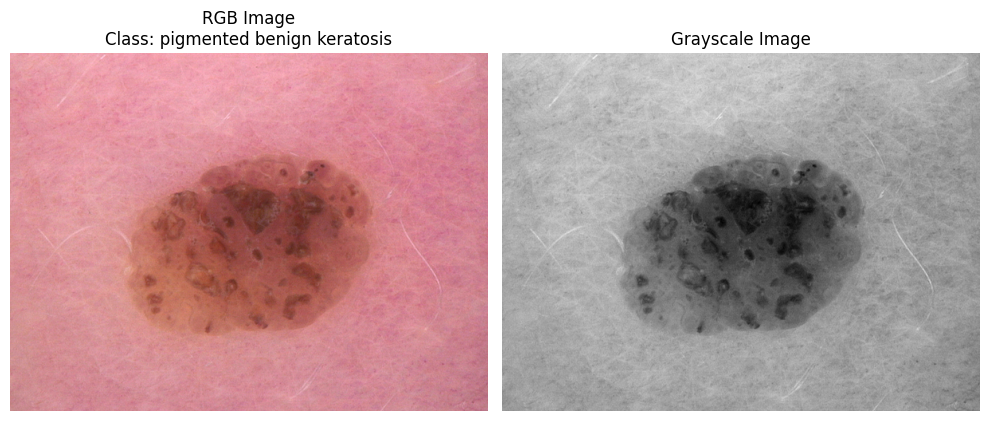

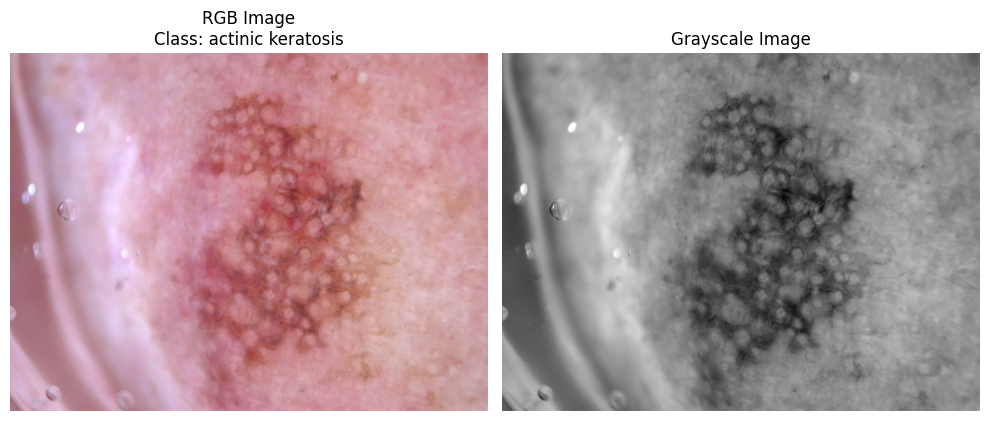

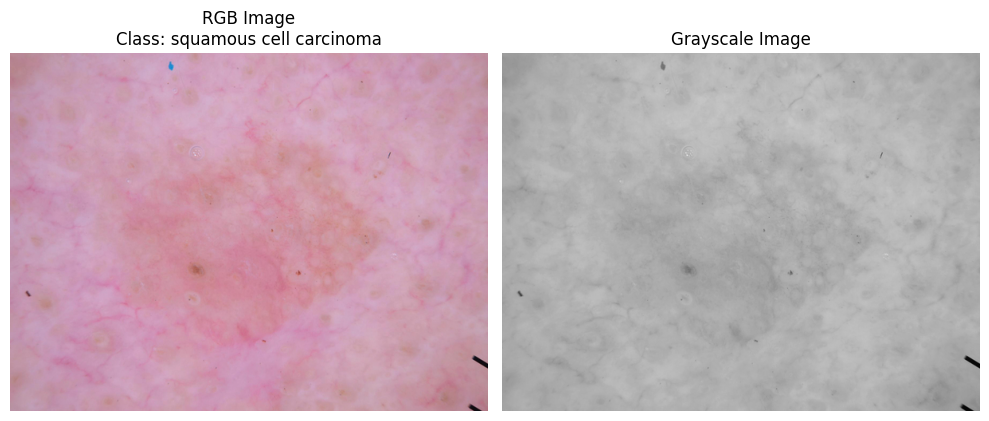

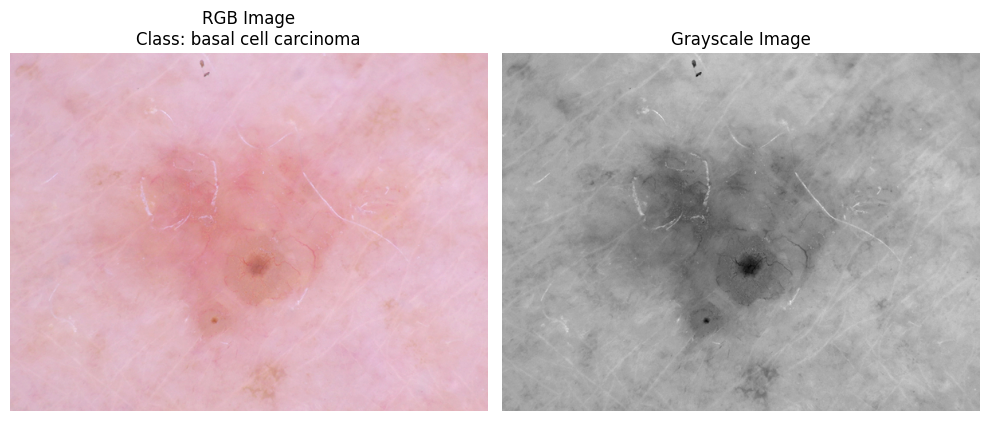

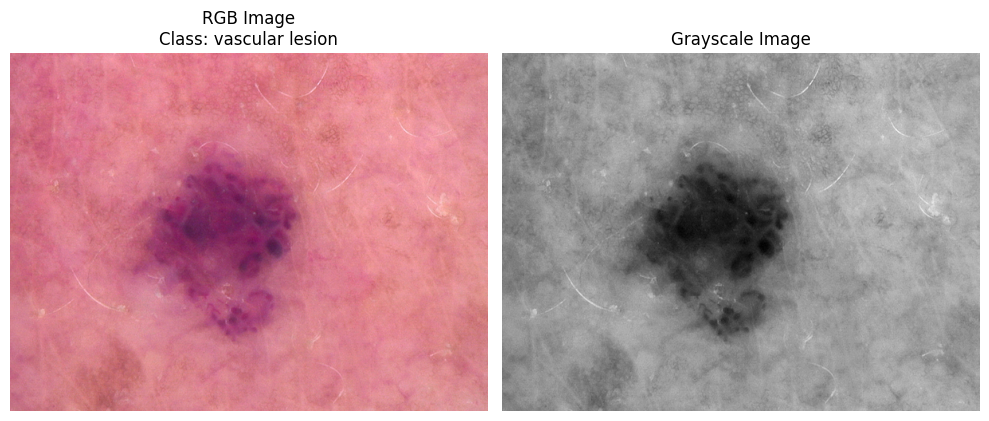

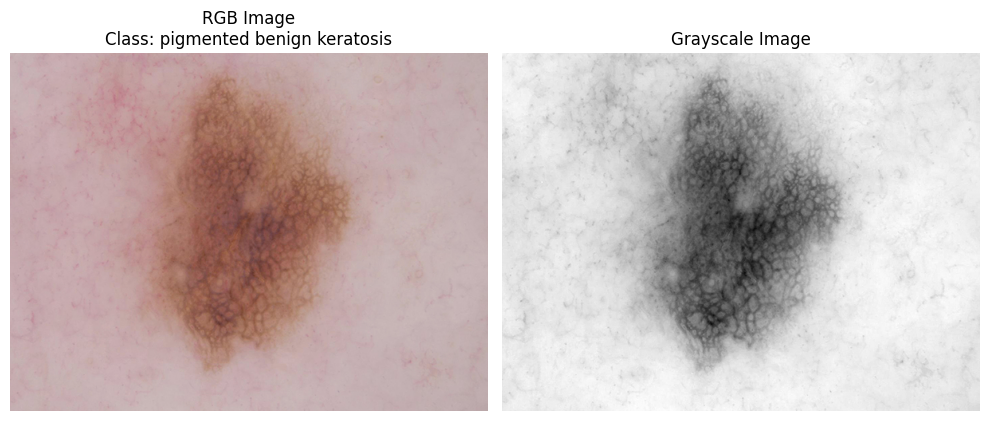

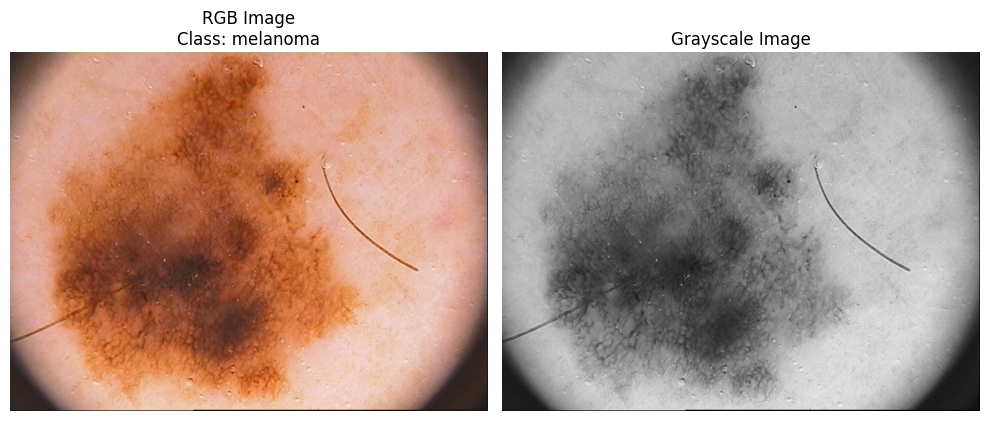

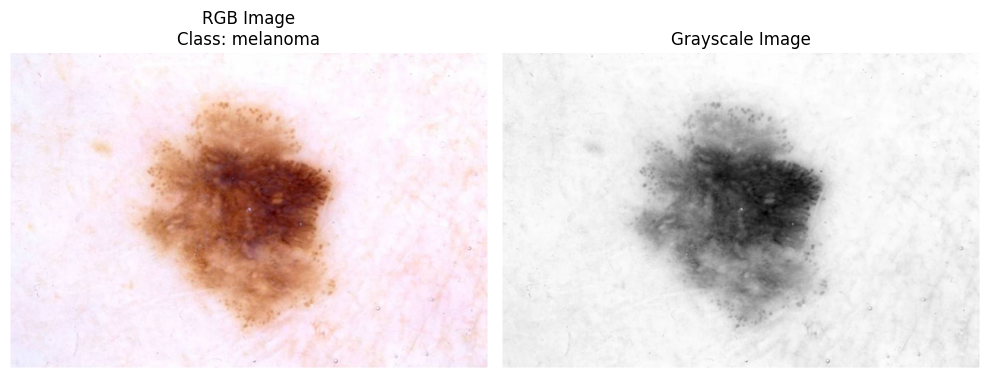

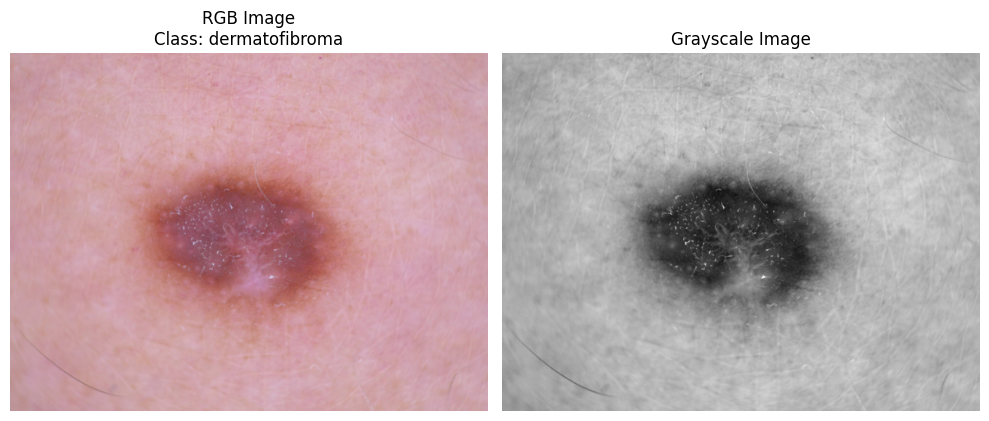

In [ ]:
plt.figure(figsize=(15, 15))

for i, row in random_sample_df.iterrows():
    image_path = row['image_path']
    label = row['label']
    class_name = label_map[label] # Get class name from label_map

    img = Image.open(image_path)
    img_gray = img.convert('L')

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title(f'RGB Image\nClass: {class_name}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(img_gray, cmap='gray')
    plt.title('Grayscale Image')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
for i, row in random_sample_df.iterrows():
    image_path = row['image_path']
    label = row['label']
    class_name = label_map[label]

    img = Image.open(image_path)
    img_gray = img.convert('L')

    # Convert images to numpy arrays for calculations
    img_np = np.array(img)
    img_gray_np = np.array(img_gray)

    print(f"\n--- Image: {os.path.basename(image_path)} (Class: {class_name}) ---")

    # RGB Statistics
    print("RGB Image Statistics:")
    print(f"  Min pixel value: {np.min(img_np)}")
    print(f"  Max pixel value: {np.max(img_np)}")
    print(f"  Mean pixel value: {np.mean(img_np):.2f}")
    print(f"  Std Dev pixel value: {np.std(img_np):.2f}")

    # Grayscale Statistics
    print("Grayscale Image Statistics:")
    print(f"  Min pixel value: {np.min(img_gray_np)}")
    print(f"  Max pixel value: {np.max(img_gray_np)}")
    print(f"  Mean pixel value: {np.mean(img_gray_np):.2f}")
    print(f"  Std Dev pixel value: {np.std(img_gray_np):.2f}")


--- Image: ISIC_0025392.jpg (Class: pigmented benign keratosis) ---
RGB Image Statistics:
  Min pixel value: 21
  Max pixel value: 255
  Mean pixel value: 159.58
  Std Dev pixel value: 44.91
Grayscale Image Statistics:
  Min pixel value: 51
  Max pixel value: 226
  Mean pixel value: 155.65
  Std Dev pixel value: 26.66

--- Image: ISIC_0033705.jpg (Class: actinic keratosis) ---
RGB Image Statistics:
  Min pixel value: 36
  Max pixel value: 255
  Mean pixel value: 167.67
  Std Dev pixel value: 37.06
Grayscale Image Statistics:
  Min pixel value: 65
  Max pixel value: 255
  Mean pixel value: 163.54
  Std Dev pixel value: 26.16

--- Image: ISIC_0025831.jpg (Class: squamous cell carcinoma) ---
RGB Image Statistics:
  Min pixel value: 1
  Max pixel value: 255
  Mean pixel value: 177.01
  Std Dev pixel value: 23.54
Grayscale Image Statistics:
  Min pixel value: 6
  Max pixel value: 245
  Mean pixel value: 170.51
  Std Dev pixel value: 8.70

--- Image: ISIC_0031169.jpg (Class: basal cell carc


--- Histograms for Image: ISIC_0025392.jpg (Class: pigmented benign keratosis) ---


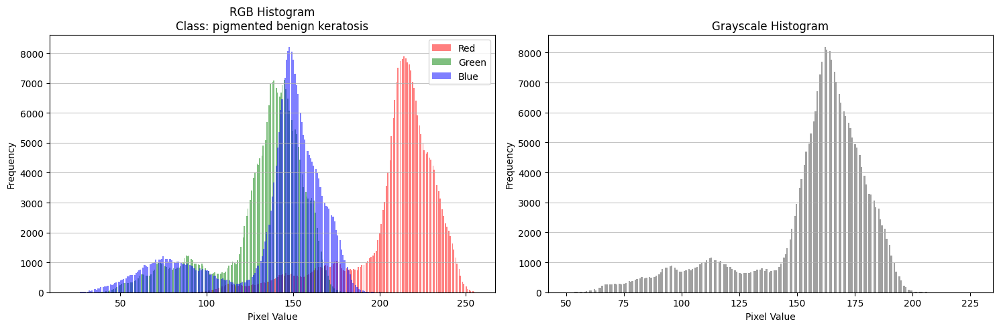


--- Histograms for Image: ISIC_0033705.jpg (Class: actinic keratosis) ---


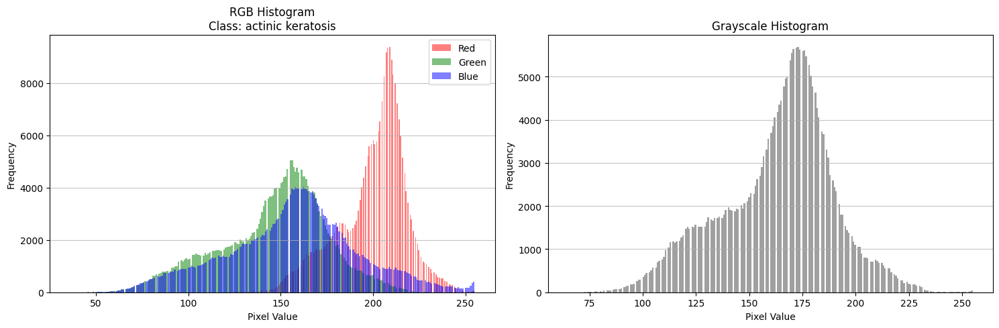


--- Histograms for Image: ISIC_0025831.jpg (Class: squamous cell carcinoma) ---


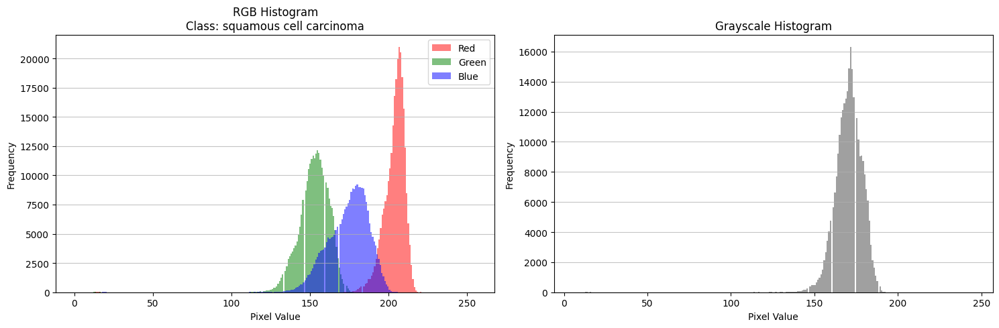


--- Histograms for Image: ISIC_0031169.jpg (Class: basal cell carcinoma) ---


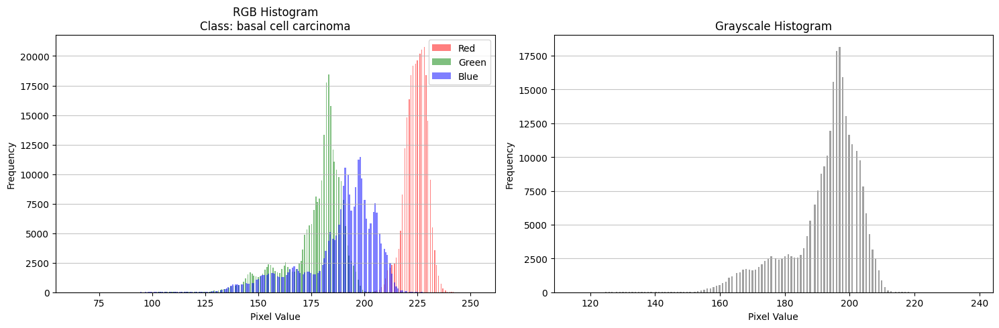


--- Histograms for Image: ISIC_0031215.jpg (Class: vascular lesion) ---


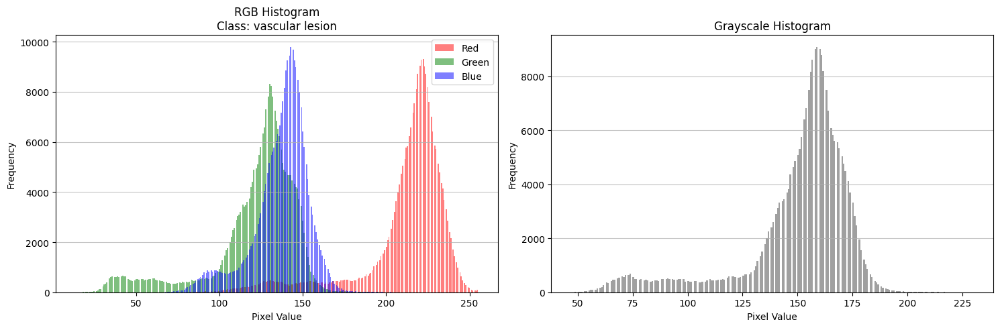


--- Histograms for Image: ISIC_0026142.jpg (Class: pigmented benign keratosis) ---


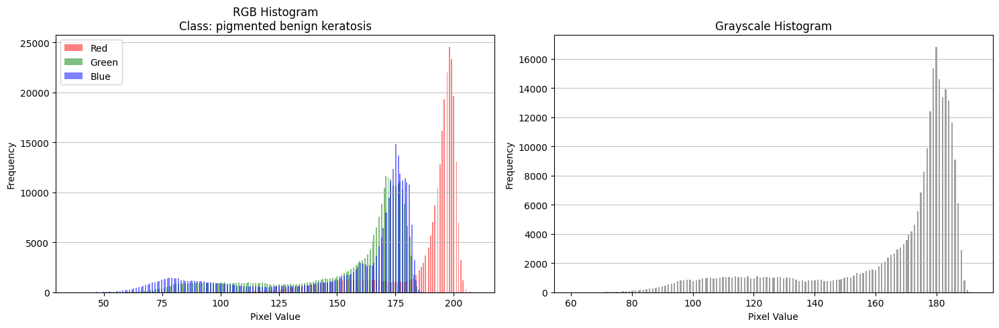


--- Histograms for Image: ISIC_0000300.jpg (Class: melanoma) ---


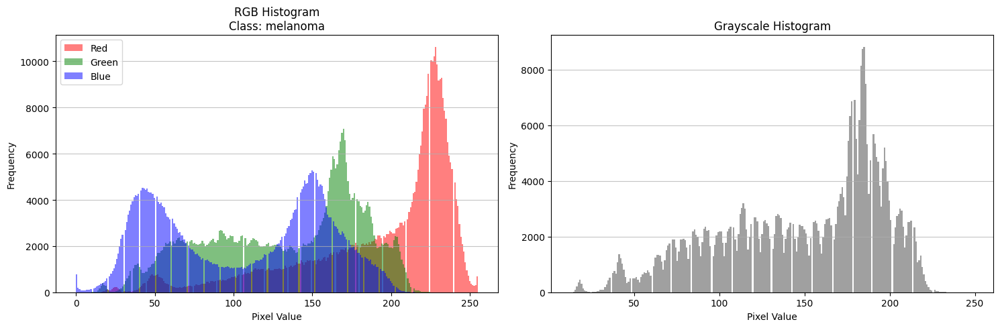


--- Histograms for Image: ISIC_0000175.jpg (Class: melanoma) ---


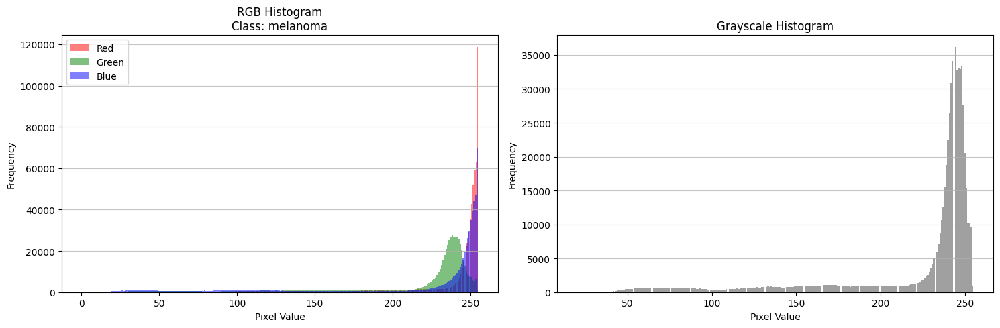


--- Histograms for Image: ISIC_0030021.jpg (Class: dermatofibroma) ---


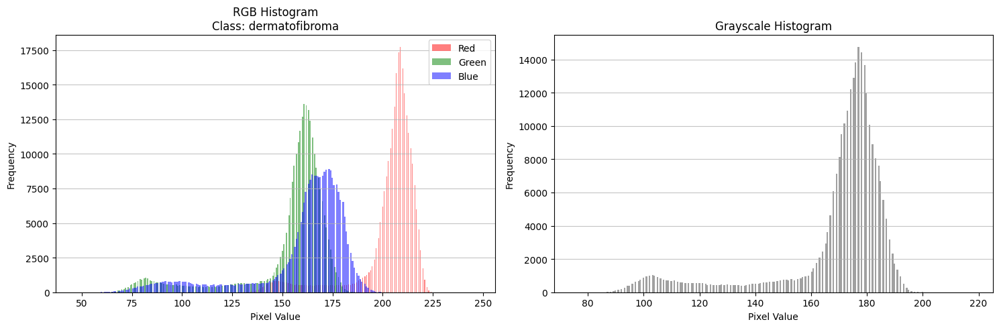

In [ ]:
for i, row in random_sample_df.iterrows():
    image_path = row['image_path']
    label = row['label']
    class_name = label_map[label]

    img = Image.open(image_path)
    img_gray = img.convert('L')

    img_np = np.array(img)
    img_gray_np = np.array(img_gray)

    print(f"\n--- Histograms for Image: {os.path.basename(image_path)} (Class: {class_name}) ---")

    # Plot RGB Histograms
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    plt.title(f'RGB Histogram\nClass: {class_name}')
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.hist(img_np[:, :, 0].ravel(), bins=256, color='red', alpha=0.5, label='Red')
    plt.hist(img_np[:, :, 1].ravel(), bins=256, color='green', alpha=0.5, label='Green')
    plt.hist(img_np[:, :, 2].ravel(), bins=256, color='blue', alpha=0.5, label='Blue')
    plt.legend()
    plt.grid(axis='y', alpha=0.75)

    # Plot Grayscale Histogram
    plt.subplot(1, 2, 2)
    plt.title('Grayscale Histogram')
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.hist(img_gray_np.ravel(), bins=256, color='gray', alpha=0.75)
    plt.grid(axis='y', alpha=0.75)

    plt.tight_layout()
    plt.show()

# **2. Bölümün Yorumlanması ve Analizi**

RGB histogramlara baktığımızda, geniş bir aralığa yayılmanın yüksek kontrastı ve zengin renk tonlarını; dar bir aralığın ise düşük kontrastı gösterdiğini görüyoruz. Genelde kırmızı ve yeşil kanalların daha geniş dağıldığını da gözlemliyoruz.

Gri tonlamalı histogramda ise tek kanalda siyah–beyaz arasındaki yoğunluğu inceliyoruz. Histogramın orta tonlarda yoğunlaşması resmin daha dengeli olduğunu, uçlara yayılması ise kontrastın arttığını anlıyoruz.

Bu histogramlar, görüntülerin renk ve parlaklık dağılımlarını anlamamıza yardımcı oluyor. Özellikle farklı lezyon türleri arasındaki ton farklarını tespit etmek için önemli bilgiler sağladığını görüyoruz.


# **3. Görüntü İşleme ve İyileştirme**

In [ ]:
selected_image_data = df.sample(n=1, random_state=42).iloc[0]
image_path = selected_image_data['image_path']
image_label = selected_image_data['label']
class_name = label_map[image_label]

print(f"Selected image: {os.path.basename(image_path)}")
print(f"Class: {class_name}")


Selected image: ISIC_0026790.jpg
Class: pigmented benign keratosis


/tmp/ipython-input-643828838.py:28: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  stretched_rgb_img_pil = Image.fromarray(stretched_rgb_np, 'RGB')
/tmp/ipython-input-643828838.py:32: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  stretched_gray_img_pil = Image.fromarray(stretched_gray_np, 'L')


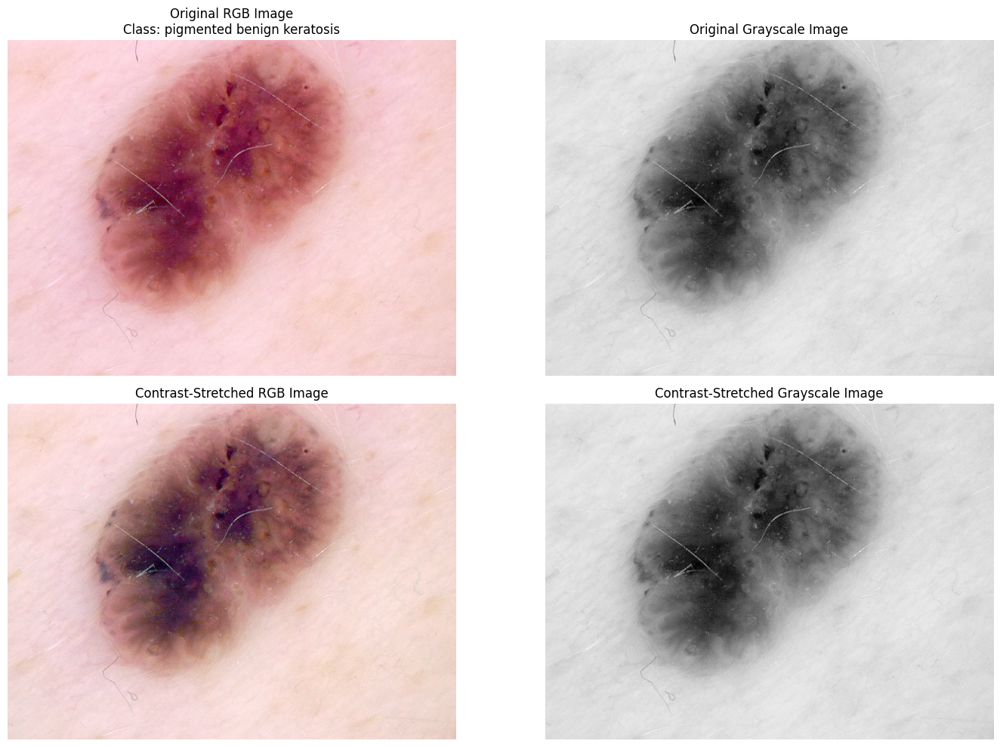

In [ ]:
from PIL import Image, ImageOps

# Load the selected image in RGB format
original_rgb_img_pil = Image.open(image_path).convert('RGB')
original_rgb_np = np.array(original_rgb_img_pil)

# Convert the RGB image to grayscale
original_gray_img_pil = original_rgb_img_pil.convert('L')
original_gray_np = np.array(original_gray_img_pil)

def contrast_stretch(image_channel):
    """
    Applies contrast stretching to a single image channel.
    """
    min_val = np.min(image_channel)
    max_val = np.max(image_channel)

    if min_val == max_val: # Avoid division by zero if all pixels are the same
        return image_channel

    stretched_channel = ((image_channel - min_val) / (max_val - min_val)) * 255
    return np.clip(stretched_channel, 0, 255).astype(np.uint8)

# Apply contrast stretching to RGB image (channel by channel)
stretched_rgb_np = np.zeros_like(original_rgb_np)
for i in range(3):
    stretched_rgb_np[:, :, i] = contrast_stretch(original_rgb_np[:, :, i])
stretched_rgb_img_pil = Image.fromarray(stretched_rgb_np, 'RGB')

# Apply contrast stretching to grayscale image
stretched_gray_np = contrast_stretch(original_gray_np)
stretched_gray_img_pil = Image.fromarray(stretched_gray_np, 'L')

# Plotting original and stretched images
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(original_rgb_img_pil)
plt.title(f'Original RGB Image\nClass: {class_name}')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(original_gray_img_pil, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(stretched_rgb_img_pil)
plt.title('Contrast-Stretched RGB Image')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(stretched_gray_img_pil, cmap='gray')
plt.title('Contrast-Stretched Grayscale Image')
plt.axis('off')

plt.tight_layout()
plt.show()

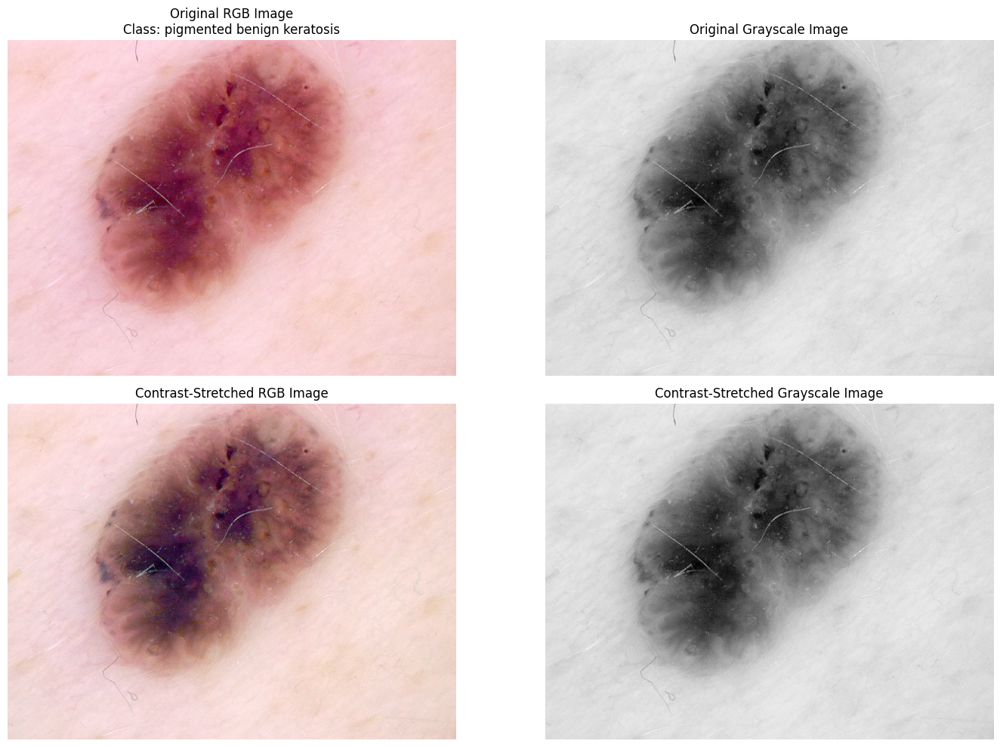

In [ ]:
from PIL import Image, ImageOps

# Load the selected image in RGB format
original_rgb_img_pil = Image.open(image_path).convert('RGB')
original_rgb_np = np.array(original_rgb_img_pil)

# Convert the RGB image to grayscale
original_gray_img_pil = original_rgb_img_pil.convert('L')
original_gray_np = np.array(original_gray_img_pil)

def contrast_stretch(image_channel):
    """
    Applies contrast stretching to a single image channel.
    """
    min_val = np.min(image_channel)
    max_val = np.max(image_channel)

    if min_val == max_val: # Avoid division by zero if all pixels are the same
        return image_channel

    stretched_channel = ((image_channel - min_val) / (max_val - min_val)) * 255
    return np.clip(stretched_channel, 0, 255).astype(np.uint8)

# Apply contrast stretching to RGB image (channel by channel)
stretched_rgb_np = np.zeros_like(original_rgb_np)
for i in range(3):
    stretched_rgb_np[:, :, i] = contrast_stretch(original_rgb_np[:, :, i])
stretched_rgb_img_pil = Image.fromarray(stretched_rgb_np)

# Apply contrast stretching to grayscale image
stretched_gray_np = contrast_stretch(original_gray_np)
stretched_gray_img_pil = Image.fromarray(stretched_gray_np)

# Plotting original and stretched images
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(original_rgb_img_pil)
plt.title(f'Original RGB Image\nClass: {class_name}')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(original_gray_img_pil, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(stretched_rgb_img_pil)
plt.title('Contrast-Stretched RGB Image')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(stretched_gray_img_pil, cmap='gray')
plt.title('Contrast-Stretched Grayscale Image')
plt.axis('off')

plt.tight_layout()
plt.show()

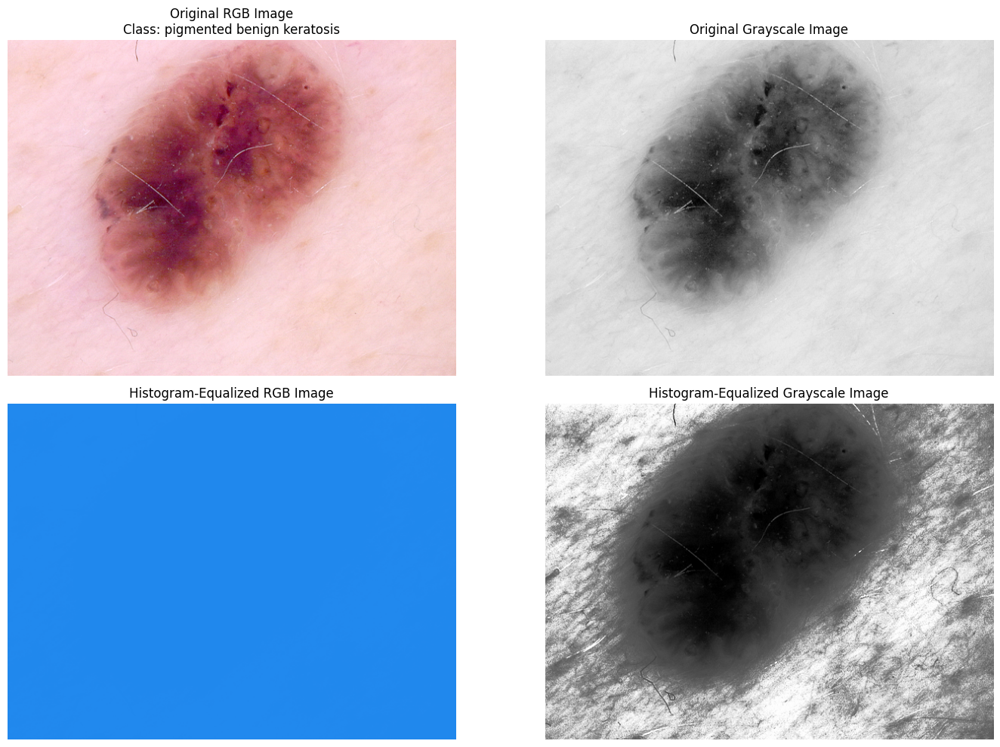

In [ ]:
from skimage import exposure, color

# Convert original RGB image to float and YCrCb
original_rgb_float = original_rgb_np / 255.0
ycrcb_img = color.ycbcr2rgb(original_rgb_float)

# Equalize the Y (luminance) channel
ycrcb_img[:, :, 0] = exposure.equalize_hist(ycrcb_img[:, :, 0])

# Convert back to RGB, scale to 0-255 and convert to uint8
equalized_rgb_np = (color.ycbcr2rgb(ycrcb_img) * 255).astype(np.uint8)



# Convert original grayscale image to float
original_gray_float = original_gray_np / 255.0

# Apply histogram equalization to grayscale image
equalized_gray_float = exposure.equalize_hist(original_gray_float)

# Scale to 0-255 and convert to uint8
equalized_gray_np = (equalized_gray_float * 255).astype(np.uint8)

# Plotting original and equalized images
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(original_rgb_np)
plt.title(f'Original RGB Image\nClass: {class_name}')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(original_gray_np, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(equalized_rgb_np)
plt.title('Histogram-Equalized RGB Image')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(equalized_gray_np, cmap='gray')
plt.title('Histogram-Equalized Grayscale Image')
plt.axis('off')

plt.tight_layout()
plt.show()

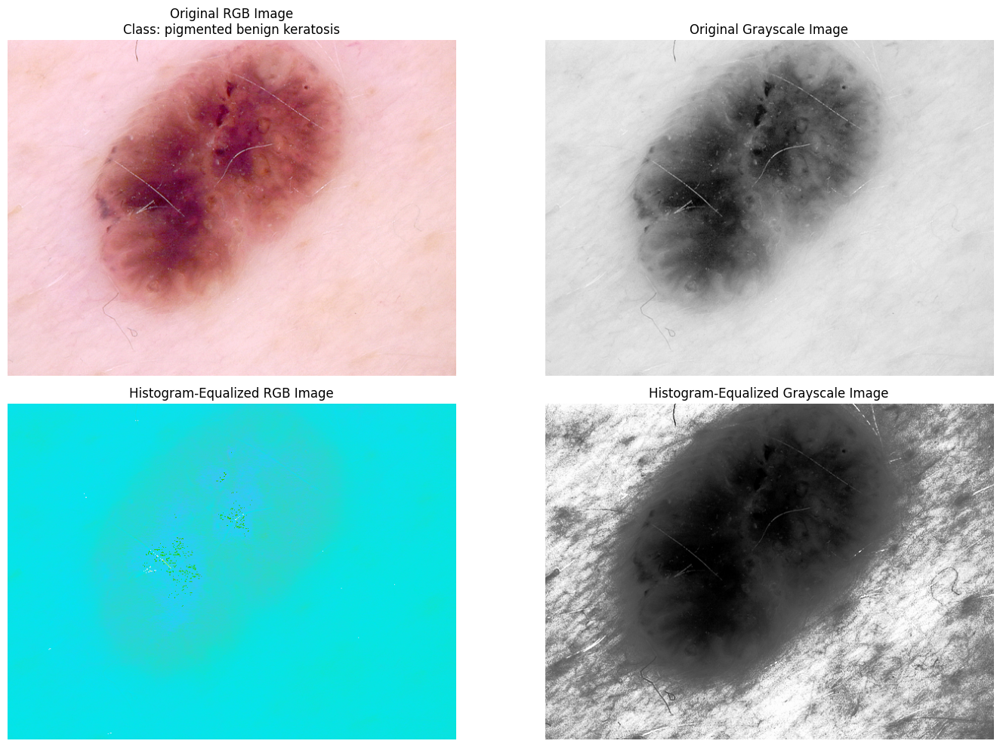

In [ ]:
from skimage import exposure, color

# Convert original RGB image to float and YCbCr
original_rgb_float = original_rgb_np / 255.0
ycbcr_img = color.rgb2ycbcr(original_rgb_float)

# Equalize the Y (luminance) channel
ycbcr_img[:, :, 0] = exposure.equalize_hist(ycbcr_img[:, :, 0])

# Convert back to RGB, scale to 0-255 and convert to uint8
equalized_rgb_np = (color.ycbcr2rgb(ycbcr_img) * 255).astype(np.uint8)

# Convert original grayscale image to float
original_gray_float = original_gray_np / 255.0

# Apply histogram equalization to grayscale image
equalized_gray_float = exposure.equalize_hist(original_gray_float)

# Scale to 0-255 and convert to uint8
equalized_gray_np = (equalized_gray_float * 255).astype(np.uint8)

# Plotting original and equalized images
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(original_rgb_np)
plt.title(f'Original RGB Image\nClass: {class_name}')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(original_gray_np, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(equalized_rgb_np)
plt.title('Histogram-Equalized RGB Image')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(equalized_gray_np, cmap='gray')
plt.title('Histogram-Equalized Grayscale Image')
plt.axis('off')

plt.tight_layout()
plt.show()

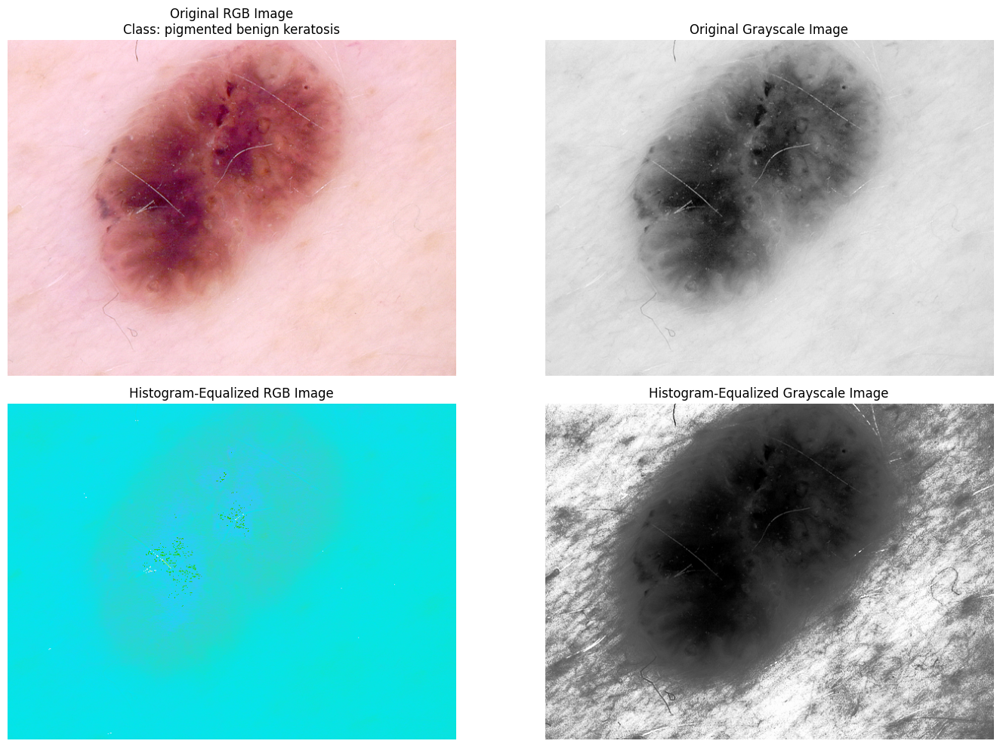

In [ ]:
from skimage import exposure, color

# Convert original RGB image to float and YCbCr
original_rgb_float = original_rgb_np / 255.0
ycbcr_img = color.rgb2ycbcr(original_rgb_float)

# Equalize the Y (luminance) channel
ycbcr_img[:, :, 0] = exposure.equalize_hist(ycbcr_img[:, :, 0])

# Convert back to RGB, scale to 0-255 and convert to uint8
equalized_rgb_np = (color.ycbcr2rgb(ycbcr_img) * 255).astype(np.uint8)

# Convert original grayscale image to float
original_gray_float = original_gray_np / 255.0

# Apply histogram equalization to grayscale image
equalized_gray_float = exposure.equalize_hist(original_gray_float)

# Scale to 0-255 and convert to uint8
equalized_gray_np = (equalized_gray_float * 255).astype(np.uint8)

# Plotting original and equalized images
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(original_rgb_np)
plt.title(f'Original RGB Image\nClass: {class_name}')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(original_gray_np, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(equalized_rgb_np)
plt.title('Histogram-Equalized RGB Image')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(equalized_gray_np, cmap='gray')
plt.title('Histogram-Equalized Grayscale Image')
plt.axis('off')

plt.tight_layout()
plt.show()

# **3. Bölümün Özeti ve Kısa Notlar**

Histogram eşitleme uygulandıktan sonra görüntülerde belirgin değişiklikler ortaya çıktı. Hem RGB hem de gri tonlamalı görüntülerde kontrastın arttığını görüyoruz. Piksel değerleri 0–255 aralığına daha dengeli yayıldığı için, özellikle soluk kalan bölgelerin daha net hale geldiğini gözlemliyoruz.

Ayrıca karanlık ya da çok parlak kısımlarda kaybolan bazı detayların daha görünür olduğunu anlıyoruz. Bu durum, özellikle cilt lezyonlarının sınırlarını ve dokularını incelemeyi kolaylaştırıyor diyebiliriz.

RGB görüntülerde sadece YCbCr dönüşümündeki “Y” kanalını eşitlediğim için renklerin genel yapısının korunduğunu görüyoruz. Yine de kontrast ve parlaklık artışı nedeniyle renklerin biraz daha canlı hale geldiğini gözlemliyoruz.

Gri tonlamalı görüntülerde ise piksel dağılımının daha homojen bir yapıya kavuştuğunu anlıyoruz. Bu da parlaklık geçişlerinin daha yumuşak olmasını sağlıyor ve görüntünün genel olarak daha anlaşılır hale geldiğini görüyoruz.

# **4. Gürültü Azaltma**

In [ ]:
from scipy.ndimage import median_filter

# Apply median filter to RGB image (channel by channel)
median_filtered_rgb_np = np.zeros_like(original_rgb_np)
filter_size = 5 # Example filter size

for i in range(3):
    median_filtered_rgb_np[:, :, i] = median_filter(original_rgb_np[:, :, i], size=filter_size)

median_filtered_rgb_pil = Image.fromarray(median_filtered_rgb_np, 'RGB')

# Apply median filter to grayscale image
median_filtered_gray_np = median_filter(original_gray_np, size=filter_size)
median_filtered_gray_pil = Image.fromarray(median_filtered_gray_np, 'L')

print(f"Median filter applied with size: {filter_size}x{filter_size}.")

/tmp/ipython-input-1925293806.py:10: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  median_filtered_rgb_pil = Image.fromarray(median_filtered_rgb_np, 'RGB')


Median filter applied with size: 5x5.


/tmp/ipython-input-1925293806.py:14: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  median_filtered_gray_pil = Image.fromarray(median_filtered_gray_np, 'L')


In [ ]:
from scipy.ndimage import median_filter

# Apply median filter to RGB image (channel by channel)
median_filtered_rgb_np = np.zeros_like(original_rgb_np)
filter_size = 5 # Example filter size

for i in range(3):
    median_filtered_rgb_np[:, :, i] = median_filter(original_rgb_np[:, :, i], size=filter_size)

median_filtered_rgb_pil = Image.fromarray(median_filtered_rgb_np)

# Apply median filter to grayscale image
median_filtered_gray_np = median_filter(original_gray_np, size=filter_size)
median_filtered_gray_pil = Image.fromarray(median_filtered_gray_np)

print(f"Median filter applied with size: {filter_size}x{filter_size}.")

Median filter applied with size: 5x5.


In [ ]:
from scipy.ndimage import gaussian_filter

# Apply Gaussian filter to RGB image (channel by channel)
gaussian_filtered_rgb_np = np.zeros_like(original_rgb_np, dtype=np.float64)
filter_sigma = 2 # Example sigma for Gaussian filter

for i in range(3):
    gaussian_filtered_rgb_np[:, :, i] = gaussian_filter(original_rgb_np[:, :, i], sigma=filter_sigma)

gaussian_filtered_rgb_pil = Image.fromarray(gaussian_filtered_rgb_np.astype(np.uint8))

# Apply Gaussian filter to grayscale image
gaussian_filtered_gray_np = gaussian_filter(original_gray_np, sigma=filter_sigma)
gaussian_filtered_gray_pil = Image.fromarray(gaussian_filtered_gray_np.astype(np.uint8))

print(f"Gaussian filter applied with sigma: {filter_sigma}.")

Gaussian filter applied with sigma: 2.


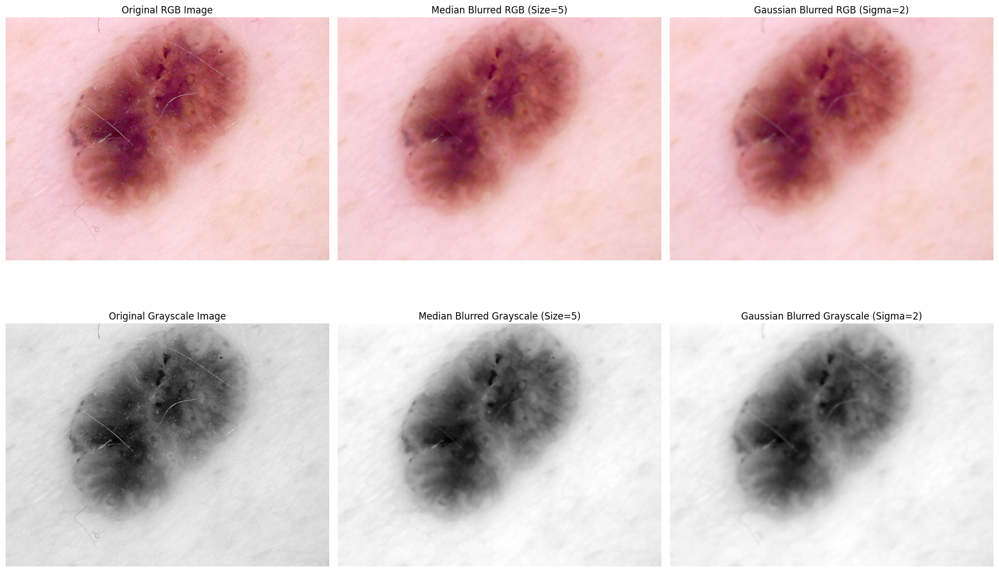

In [ ]:
plt.figure(figsize=(18, 12))

# Original RGB
plt.subplot(2, 3, 1)
plt.imshow(original_rgb_img_pil)
plt.title('Original RGB Image')
plt.axis('off')

# Median Blurred RGB
plt.subplot(2, 3, 2)
plt.imshow(median_filtered_rgb_pil)
plt.title(f'Median Blurred RGB (Size={filter_size})')
plt.axis('off')

# Gaussian Blurred RGB
plt.subplot(2, 3, 3)
plt.imshow(gaussian_filtered_rgb_pil)
plt.title(f'Gaussian Blurred RGB (Sigma={filter_sigma})')
plt.axis('off')

# Original Grayscale
plt.subplot(2, 3, 4)
plt.imshow(original_gray_img_pil, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

# Median Blurred Grayscale
plt.subplot(2, 3, 5)
plt.imshow(median_filtered_gray_pil, cmap='gray')
plt.title(f'Median Blurred Grayscale (Size={filter_size})')
plt.axis('off')

# Gaussian Blurred Grayscale
plt.subplot(2, 3, 6)
plt.imshow(gaussian_filtered_gray_pil, cmap='gray')
plt.title(f'Gaussian Blurred Grayscale (Sigma={filter_sigma})')
plt.axis('off')

plt.tight_layout()
plt.show()


##**4. Bölüm Analizi ve Yorumlaması:**

Median blur'un kenarları Gaussian blur’a göre daha iyi koruduğunu görüyoruz. Çünkü median blur, pikselleri komşularının ortanca değeriyle değiştirdiği için keskin geçişleri çok fazla bozmaz. Bu sayede hem gürültü azalıyor hem de kenarlar daha net kalıyor diyebiliriz.

Gaussian blur uygulandığında bazı detayların belirgin şekilde kaybolduğunu gözlemliyoruz. Ağırlıklı ortalama yaparak tüm görüntüyü yumuşattığı için hem ince detaylar hem de kenarlar daha fazla bulanık hale geliyor. Bu yüzden Gaussian blur’un detay koruma açısından daha zayıf olduğunu anlıyoruz.

# ***5. Döndürme ve Ayna Çevirme (Flipping)***

In [ ]:
from scipy.ndimage import rotate
import random

# Generate a random rotation angle between 0 and 10 degrees
rotation_angle = random.uniform(0, 10)

# Apply rotation to RGB image (channel by channel)
rotated_rgb_np = np.zeros_like(original_rgb_np)

# Determine fill value for RGB (e.g., mean pixel value or black)
r_mean, g_mean, b_mean = np.mean(original_rgb_np[:,:,0]), np.mean(original_rgb_np[:,:,1]), np.mean(original_rgb_np[:,:,2])

for i in range(3):
    rotated_rgb_np[:, :, i] = rotate(original_rgb_np[:, :, i], angle=rotation_angle, reshape=False, mode='constant', cval=0).astype(np.uint8) # Using 0 for black fill

rotated_rgb_pil = Image.fromarray(rotated_rgb_np, 'RGB')

# Apply rotation to grayscale image
# Determine fill value for grayscale (e.g., mean pixel value or black)
gray_mean = np.mean(original_gray_np)
rotated_gray_np = rotate(original_gray_np, angle=rotation_angle, reshape=False, mode='constant', cval=0).astype(np.uint8) # Using 0 for black fill
rotated_gray_pil = Image.fromarray(rotated_gray_np, 'L')

print(f"Applied random rotation angle: {rotation_angle:.2f} degrees.")

Applied random rotation angle: 8.33 degrees.


/tmp/ipython-input-1975107417.py:16: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  rotated_rgb_pil = Image.fromarray(rotated_rgb_np, 'RGB')
/tmp/ipython-input-1975107417.py:22: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  rotated_gray_pil = Image.fromarray(rotated_gray_np, 'L')


In [ ]:
from scipy.ndimage import rotate
import random

# Generate a random rotation angle between 0 and 10 degrees
rotation_angle = random.uniform(0, 10)

# Apply rotation to RGB image (channel by channel)
rotated_rgb_np = np.zeros_like(original_rgb_np)

# Determine fill value for RGB (e.g., mean pixel value or black)
r_mean, g_mean, b_mean = np.mean(original_rgb_np[:,:,0]), np.mean(original_rgb_np[:,:,1]), np.mean(original_rgb_np[:,:,2])

for i in range(3):
    rotated_rgb_np[:, :, i] = rotate(original_rgb_np[:, :, i], angle=rotation_angle, reshape=False, mode='constant', cval=0).astype(np.uint8) # Using 0 for black fill

rotated_rgb_pil = Image.fromarray(rotated_rgb_np)

# Apply rotation to grayscale image
# Determine fill value for grayscale (e.g., mean pixel value or black)
gray_mean = np.mean(original_gray_np)
rotated_gray_np = rotate(original_gray_np, angle=rotation_angle, reshape=False, mode='constant', cval=0).astype(np.uint8) # Using 0 for black fill
rotated_gray_pil = Image.fromarray(rotated_gray_np)

print(f"Applied random rotation angle: {rotation_angle:.2f} degrees.")

Applied random rotation angle: 9.81 degrees.


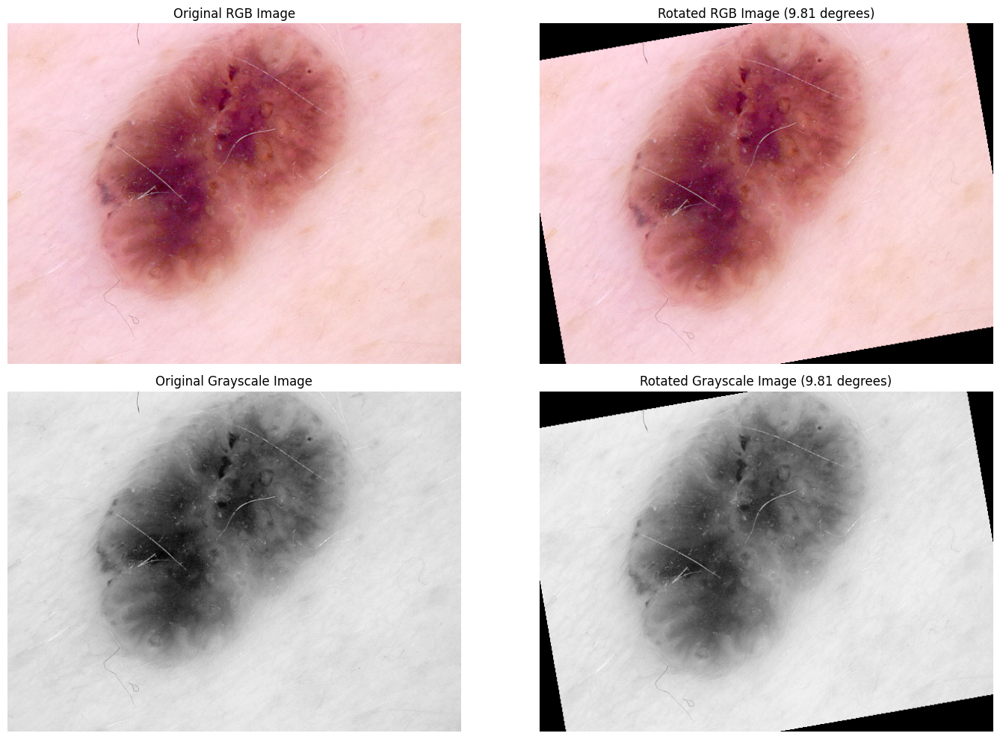

In [ ]:
plt.figure(figsize=(15, 10))

# Original RGB
plt.subplot(2, 2, 1)
plt.imshow(original_rgb_img_pil)
plt.title('Original RGB Image')
plt.axis('off')

# Rotated RGB
plt.subplot(2, 2, 2)
plt.imshow(rotated_rgb_pil)
plt.title(f'Rotated RGB Image ({rotation_angle:.2f} degrees)')
plt.axis('off')

# Original Grayscale
plt.subplot(2, 2, 3)
plt.imshow(original_gray_img_pil, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

# Rotated Grayscale
plt.subplot(2, 2, 4)
plt.imshow(rotated_gray_pil, cmap='gray')
plt.title(f'Rotated Grayscale Image ({rotation_angle:.2f} degrees)')
plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
from PIL import Image

# Apply horizontal flip to RGB image
flipped_rgb_np = np.fliplr(original_rgb_np)
flipped_rgb_pil = Image.fromarray(flipped_rgb_np)

# Apply horizontal flip to grayscale image
flipped_gray_np = np.fliplr(original_gray_np)
flipped_gray_pil = Image.fromarray(flipped_gray_np)

print("Horizontal flip applied to RGB and grayscale images.")

Horizontal flip applied to RGB and grayscale images.


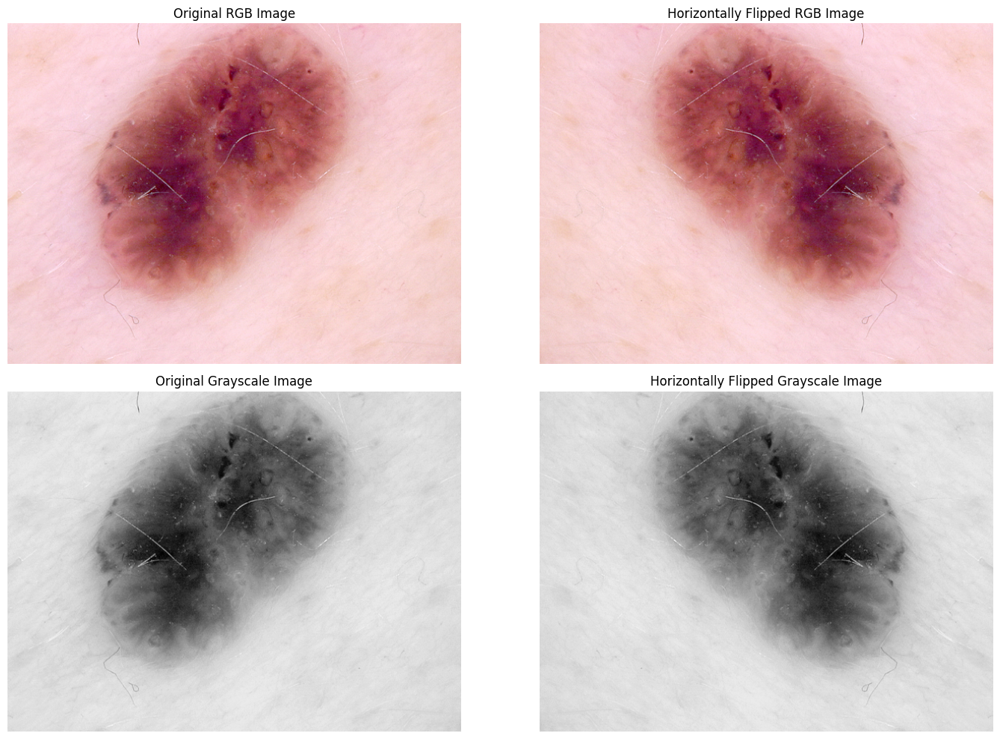

In [ ]:
plt.figure(figsize=(15, 10))

# Original RGB
plt.subplot(2, 2, 1)
plt.imshow(original_rgb_img_pil)
plt.title('Original RGB Image')
plt.axis('off')

# Flipped RGB
plt.subplot(2, 2, 2)
plt.imshow(flipped_rgb_pil)
plt.title('Horizontally Flipped RGB Image')
plt.axis('off')

# Original Grayscale
plt.subplot(2, 2, 3)
plt.imshow(original_gray_img_pil, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

# Flipped Grayscale
plt.subplot(2, 2, 4)
plt.imshow(flipped_gray_pil, cmap='gray')
plt.title('Horizontally Flipped Grayscale Image')
plt.axis('off')

plt.tight_layout()
plt.show()

**## 5. Bölüm Analizi ve Yorumlaması**

Bu bölümde, seçilen görüntülere uygulanan rastgele döndürme ve yatay ayna çevirme (flipping) işlemlerinin görsel etkileri gözlemlendi.

### Rastgele Döndürme (0-10 Derece):

*   **Etki**: Görüntü, belirlenen aralıkta rastgele bir açıyla saat yönünde hafifçe döndürülmüştür. Bu dönüş, görüntünün kenarlarında boş piksellerin (siyah) oluşmasına neden olmuştur, çünkü `reshape=False` ve `cval=0` kullanılmıştır. Bu boş alanlar, veri artırma senaryolarında genellikle dolgu veya kırpma ile yapılır

### Yatay Ayna Çevirme (Horizontal Flipping):

*   **Etki**: Görüntünün yatay eksende simetrik olarak çevrilmesiyle nesnenin sağ-sol konumu tersine döndürüldü.


### Genel Değerlendirme:
Her iki yöntemde de içeriği değiştirmeden görüntü de mekansal değişiklik yaparak yeni varyasyonlar üretildiğini gözlemledim. Bu yöntemler data miktarının arttırılmasında etkili olabilir

# **6. Frekans Alanında Filtreleme (FFT)**

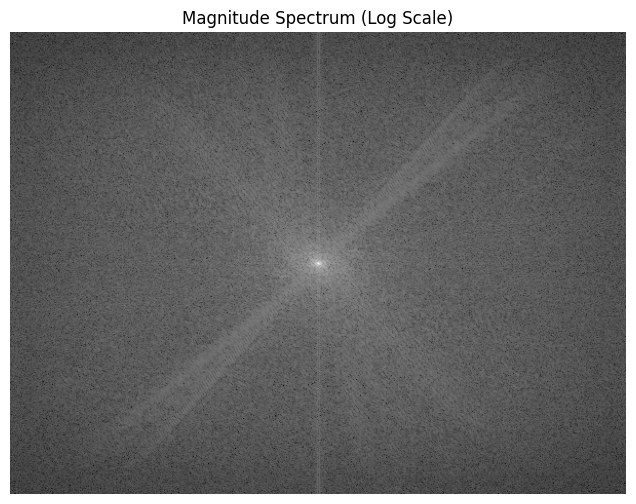

2D FFT applied, zero-frequency component shifted, and magnitude spectrum visualized.


In [ ]:
from numpy.fft import fft2, fftshift

# Apply 2D FFT to the grayscale image
fft_gray = fft2(original_gray_np)

# Shift the zero-frequency component to the center
fft_shifted = fftshift(fft_gray)

# Calculate the magnitude spectrum
magnitude_spectrum = np.abs(fft_shifted)

# Apply logarithmic transformation for better visualization
magnitude_spectrum_log = 20 * np.log(magnitude_spectrum + 1) # Add 1 to avoid log(0)

# Display the magnitude spectrum
plt.figure(figsize=(8, 6))
plt.imshow(magnitude_spectrum_log, cmap='gray')
plt.title('Magnitude Spectrum (Log Scale)')
plt.axis('off')
plt.show()

print("2D FFT applied, zero-frequency component shifted, and magnitude spectrum visualized.")

In [ ]:
rows, cols = fft_shifted.shape

# Create a 2D array of zeros for the mask
mask = np.zeros((rows, cols), dtype=np.uint8)

# Define the center coordinates
crow, ccol = rows // 2, cols // 2

# Define a radius for the low-pass filter
radius = 30 # You can adjust this value (e.g., 50) for different filtering strengths

# Create a circular mask (white in the center, black at the edges)
x, y = np.ogrid[:rows, :cols]
mask_circle = (x - crow)**2 + (y - ccol)**2 <= radius**2
mask[mask_circle] = 1

# Apply the low-pass filter mask to the shifted FFT
fshift_lpf_filtered = fft_shifted * mask

print(f"Low-pass filter mask created with radius {radius} and applied to the FFT spectrum.")

Low-pass filter mask created with radius 30 and applied to the FFT spectrum.


In [ ]:
from numpy.fft import ifft2, ifftshift

# Shift the zero-frequency component back to the corner for IFFT
fshift_lpf_filtered_shifted_back = ifftshift(fshift_lpf_filtered)

# Apply inverse 2D FFT
img_lpf_filtered = ifft2(fshift_lpf_filtered_shifted_back)

# Take the real part and scale to 0-255, converting to uint8
img_lpf_filtered = np.abs(img_lpf_filtered)
img_lpf_filtered = np.clip(img_lpf_filtered, 0, 255).astype(np.uint8)

print("Inverse FFT applied and low-pass filtered image obtained.")

Inverse FFT applied and low-pass filtered image obtained.


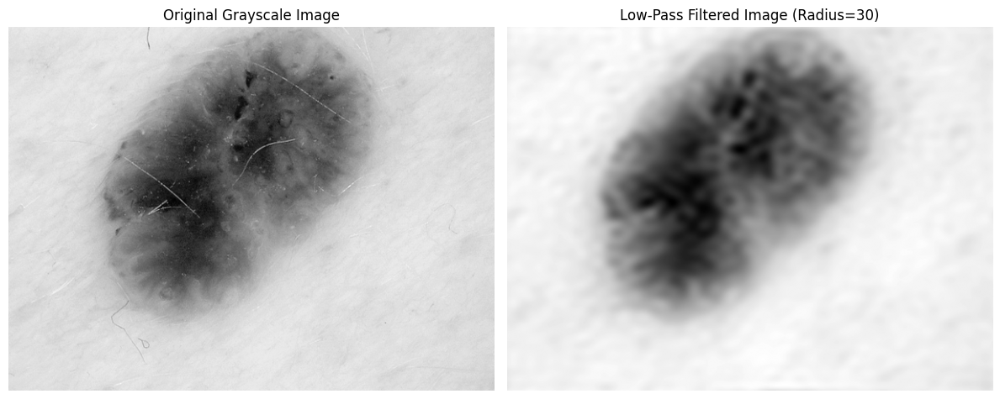

Original and low-pass filtered images displayed for comparison.


In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(original_gray_np, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_lpf_filtered, cmap='gray')
plt.title(f'Low-Pass Filtered Image (Radius={radius})')
plt.axis('off')

plt.tight_layout()
plt.show()

print("Original and low-pass filtered images displayed for comparison.")

# **6. Bölümün Analizi ve Yorum**

Alçak geçiren filtre uygulandığında görüntünün yumuşadığını ve ince detayların kaybolduğunu görüyoruz. Bu filtre yüksek frekansları kestiği için gürültü de azalıyor, dolayısıyla görüntü daha temiz ama daha bulanık bir hâle geliyor.

Yaptığım analizde gri tonlamalı görüntünün FFT için hazır olduğunu, Fourier dönüşümünü başarıyla uyguladığımı ve frekans dağılımını log ölçeğinde inceleyebildiğimi gözlemliyoruz. Yarıçapı 30 olan dairesel bir maske kullanarak yüksek frekansları engelledim ve filtrelenmiş spektrumu ters dönüşümle görüntüye geri çevirdim. Sonuç olarak, orijinal görüntüye göre daha yumuşak ve daha az gürültülü bir görüntü elde ettiğimi anlıyoruz.

Ayrıca filtre yarıçapının ne kadar kritik olduğunu da görüyoruz. Küçük bir yarıçap detayları çok fazla kaybettirirken, büyük bir yarıçap daha fazla detayı koruyor. Bu yüzden farklı yarıçaplarla denemeler yapmanın faydalı olacağını gözlemliyoruz. İleride yüksek geçiren veya bant geçiren filtrelerle de çalışarak farklı etkiler elde etmek mümkün.

# **7. Keskinleştirme ve Enterpolasyon**

Unsharp masking applied with radius=5 and amount=2.0.


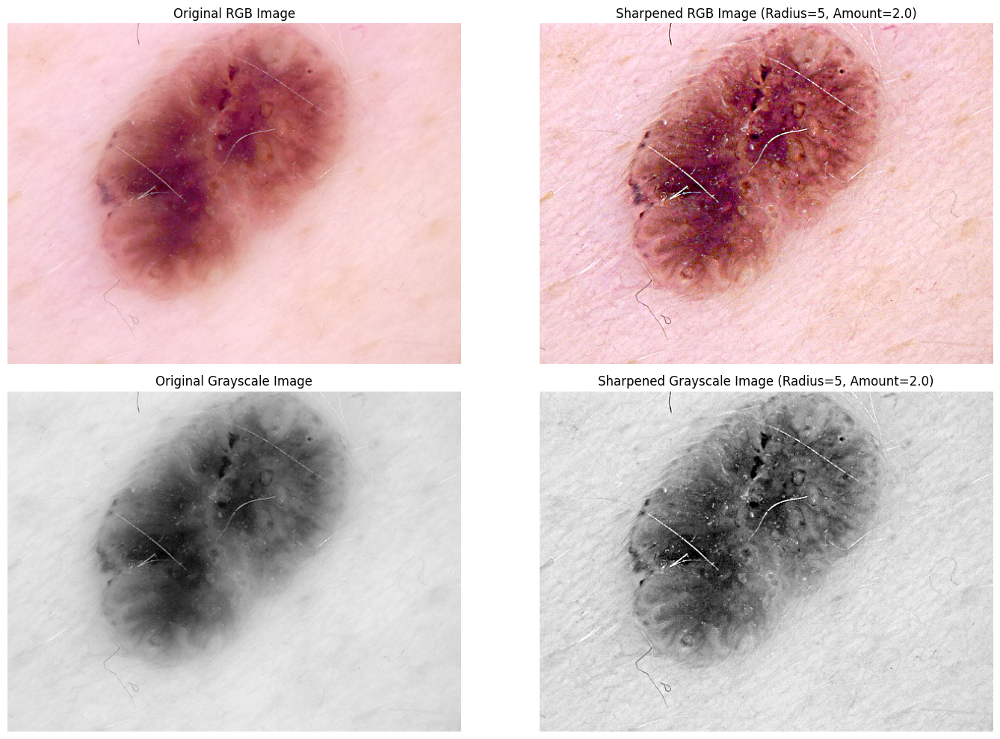

In [ ]:
from skimage.filters import unsharp_mask

# Define unsharp masking parameters
radius = 5
amount = 2.0

# Apply unsharp masking to RGB image (channel by channel)
sharpened_rgb_np = np.zeros_like(original_rgb_np, dtype=np.float64)
for i in range(3):
    # unsharp_mask returns float values, need to scale and convert to uint8
    sharpened_rgb_np[:, :, i] = unsharp_mask(original_rgb_np[:, :, i], radius=radius, amount=amount)

# Clip values to 0-255 range and convert to uint8
sharpened_rgb_np = np.clip(sharpened_rgb_np * 255, 0, 255).astype(np.uint8)
sharpened_rgb_pil = Image.fromarray(sharpened_rgb_np)

# Apply unsharp masking to grayscale image
sharpened_gray_np = unsharp_mask(original_gray_np, radius=radius, amount=amount)
sharpened_gray_np = np.clip(sharpened_gray_np * 255, 0, 255).astype(np.uint8)
sharpened_gray_pil = Image.fromarray(sharpened_gray_np)

print(f"Unsharp masking applied with radius={radius} and amount={amount}.")

# Display original and sharpened images
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(original_rgb_img_pil)
plt.title('Original RGB Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(sharpened_rgb_pil)
plt.title(f'Sharpened RGB Image (Radius={radius}, Amount={amount})')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(original_gray_img_pil, cmap='gray')
plt.title('Original Grayscale Image')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(sharpened_gray_pil, cmap='gray')
plt.title(f'Sharpened Grayscale Image (Radius={radius}, Amount={amount})')
plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
from PIL import Image

# Enlarge sharpened RGB image by 2 times using bicubic interpolation
# PIL's resize method can take a tuple (width, height)
# The order for `Image.resize` is (width, height)
enlarged_sharpened_rgb_pil = sharpened_rgb_pil.resize(
    (sharpened_rgb_pil.width * 2, sharpened_rgb_pil.height * 2),
    Image.BICUBIC
)

# Enlarge sharpened grayscale image by 2 times using bicubic interpolation
enlarged_sharpened_gray_pil = sharpened_gray_pil.resize(
    (sharpened_gray_pil.width * 2, sharpened_gray_pil.height * 2),
    Image.BICUBIC
)

print("Sharpened RGB and grayscale images enlarged by 2 times using bicubic interpolation.")

Sharpened RGB and grayscale images enlarged by 2 times using bicubic interpolation.


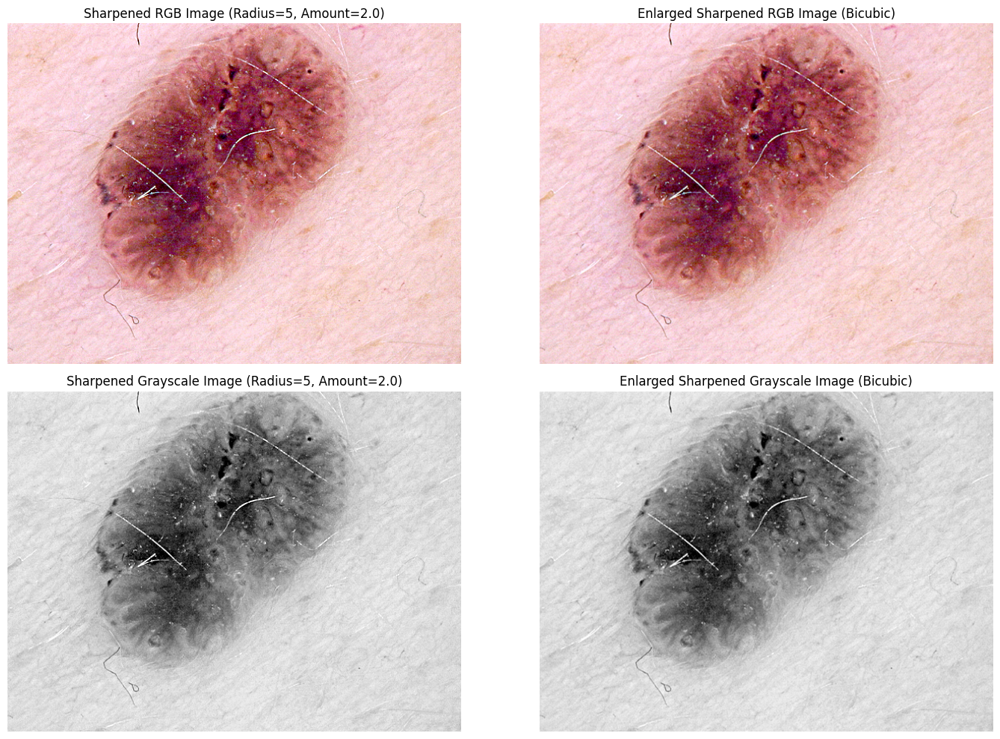

Sharpened and enlarged images displayed for comparison.


In [ ]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(sharpened_rgb_pil)
plt.title(f'Sharpened RGB Image (Radius={radius}, Amount={amount})')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(enlarged_sharpened_rgb_pil)
plt.title('Enlarged Sharpened RGB Image (Bicubic)')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(sharpened_gray_pil, cmap='gray')
plt.title(f'Sharpened Grayscale Image (Radius={radius}, Amount={amount})')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(enlarged_sharpened_gray_pil, cmap='gray')
plt.title('Enlarged Sharpened Grayscale Image (Bicubic)')
plt.axis('off')

plt.tight_layout()
plt.show()

print("Sharpened and enlarged images displayed for comparison.")

# **7. Bölümün Analizi Ve Yorum**

Unsharp masking ile görüntülerdeki detayların belirgin şekilde arttığını görüyoruz. Bu işlemden sonra bicubic interpolasyonla görüntüleri 2 kat büyüttüğümde, keskinleştirilmiş detayların büyük kısmının korunduğunu gözlemliyoruz. Yalnız bicubic yöntem bazen hafif bulanıklık ya da küçük artefaktlar bırakabiliyor; bu yüzden daha iyi değerlendirme için PSNR veya SSIM gibi ölçümlere bakmak iyi bir sonraki adım olabilir.